<a href="https://colab.research.google.com/github/ahshawaf/AML/blob/project7/Project8_CNN_Face_Expression_v1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![alt text](https://cdn.educba.com/academy/wp-content/uploads/2019/10/Unsupervised-Machine-Learning.jpg)

Unsupervised learning is a type of machine learning algorithm used to draw inferences from datasets consisting of input data without labeled responses. The most common unsupervised learning method is cluster analysis, which is used for exploratory data analysis to find hidden patterns or grouping in data. Within this experiment, the datasets (image type) and machine learning techniques are described below.

**Image Datasets:**


*   Bridge: 4x4 pixel blocks of bridge images, contained 4096 pixel blocks as txt file.   
http://cs.joensuu.fi/sipu/datasets/ 
*   Coil-100: The dataset contains 7200 color images of 100 objects (72 images per object). Total file size is 124 MB.
https://www.cs.columbia.edu/CAVE/software/softlib/coil-100.php

*   Celeb: CelebFaces Attributes Dataset (CelebA), with a total size 1.32 GB, is a large-scale face attributes dataset with more than 200K celebrity images, each with 40 attribute annotations. The images in this dataset cover large pose variations and background clutter. CelebA has large diversities, large quantities, and rich annotations, including, 10,177 number of identities, 202,599 number of face images, and 5 landmark locations, 40 binary attributes annotations per image.   
http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html
*   ImageNet: Images were collected variously on internet, come with two resolutions, 32x32 and 64x64, and total 1281149 images. 32x32 resolution with total size 3.83 GB is used in this assignment.  
http://image-net.org/small/download.php


**Machine Learning Techniques:** 


*   K-Means Clustering
*   RandomForest Classifier
*   GuassianMixture Classifier
*   Anomaly Detection Using GuassianMixture

**Additionl Tools:**


*   Github & Kaggle: for hosting datasets and python notebook
*   Tableau: for report visualization









#Setup

In [0]:
# Common Import
import sklearn
import pandas as pd
import numpy as np
from sklearn import metrics
import seaborn as sns
import os
import time
import random

import tarfile
import cv2
from google.colab.patches import cv2_imshow

# to make this notebook's output stable across runs
np.random.seed(42)

from zipfile import ZipFile

from keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler,LabelEncoder

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Ignore useless warnings (see SciPy issue #5998)
import warnings
warnings.filterwarnings(action="ignore")

# sklearn version > 0.20 is required 
sklearn.__version__
# Update sklearn -> !pip install -U scikit-learn

'0.22.2.post1'

#Custom Functions

This is a fucntion to download a file using **URL**. Then save it in the **save_path** with **target_file_name**. If target_file_name is empty, then the file name will be gotten from the URL.

In [0]:
import urllib
import urllib.parse as parse

def download(url,save_path,target_file_name=''):
  print("file is being downloading from {} ...".format(url))
  file = urllib.request.urlopen(url)
  fileData = file.read()

  if target_file_name=='':
    split=parse.urlsplit(url)
    target_file_name = split.path.split('/')[-1]
  
  if not os.path.exists(save_path):
    os.mkdir(save_path)

  targetFile = os.path.join(save_path,target_file_name)
  with open(targetFile,'wb') as f:
    f.write(fileData)
  print('Done, file in the path {}'.format(targetFile))

This is a function to extract tar file in the **tar_file_path**, which includes the file name and the extension, to **target_path**.

In [0]:
def extractTar(tar_file_path,target_path):
    print("Extracting is starting....")
    tar=tarfile.open(tar_file_path)
    tar.extractall(target_path)
    tar.close()
    print("Done")

This is a function to extract zip file in the **zip_file_path**, which includes the file name and the extension, to **target_path**.

In [0]:
def extractZip(zip_file_path,target_path):
    print("Extracting is starting....")
    zFile=ZipFile(zip_file_path)
    zFile.extractall(target_path)
    zFile.close()
    print("Done")

This is a custom function to create a imgs set without labels, unsupervised dataset. It used the folder path of the imgs.

In [0]:
def create_img_set(imgs_folder_path):
  x=[]
  lst = os.listdir(imgs_folder_path)
  for img in lst:
    img_imr = cv2.imread(os.path.join(imgs_folder_path,img))
    img_imr = cv2.resize(img_imr,(128,128))
    x.append(np.array(img_imr))
  return x

randomly_sho_imgs is for randomly display nrows x ncols images from the training set 

In [0]:
def randomly_show_imgs(x_set,nrows,ncols):
  #plt.figure(figsize=(10,10))
  for i in range(nrows*ncols):
    plt.subplot(nrows,ncols,i+1)
    indx = random.randint(0,len(x_set))
    plt.cv2.imshow(x_set[indx])
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
  plt.show()

reduceTo2D fucntion is to reduce the dimensionality of dataset to 2D using t-SNE algorithm

In [0]:
from sklearn.manifold import TSNE

def reduceTo2D(dataset):
  tsne = TSNE(n_components=2,random_state=47)
  reduced_dataset=tsne.fit_transform(dataset)
  return reduced_dataset

getRandomSubset is a function a give a shuffled subset with a specific size. It is using train_test_split to generate the subset


In [0]:
def getRandomSubset(dataset, subset_size):
  subset_size_percentage = subset_size/len(dataset)
  x_train,x_test=train_test_split(dataset,test_size=subset_size_percentage,random_state=47,shuffle=True)
  print('subset {}'.format(x_test.shape))
  return x_test


## Preprocessing Data

In [0]:
root_path = 'data'
if not os.path.exists(root_path):
  os.mkdir(root_path)

In [0]:
download('https://storage.googleapis.com/kaggle-data-sets/633155/1126184/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754502&Signature=S%2Fpoax1CqE1qKjjp4QTMD5e0UG4KuXlFJpnTJspH1m9FrrwT5EZSvgcGbyCVq9YmhslZOtBtdR3Zgq7ZTO51z1uu0WPfLOA3epbZtCTHaTxmXSmPv2zCa9cFHNMxqbSRsU9v1UxgZQnsojKrNfeId4nJTJpKjwCNLzj9LMNWVtnLTs%2Bb67pf7lSPYchUZOD%2Fowwa4KOun45ygI%2BJ1E52Dw2t8QRnEwckdU84%2Bod70CtfPLuF3GzPOpRiud2W%2FxfvOcf9skIsNvXfmlLYwPPjSy97kkJk0u6MCumT7rkeSnyZc9gZe9N%2BUYfkW6g2d9yePaVPGSfUh1fr0m4poxd8RA%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-train.zip',os.path.join(root_path,'Faces'),'face_train.zip')

file is being downloading from https://storage.googleapis.com/kaggle-data-sets/633155/1126184/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754502&Signature=S%2Fpoax1CqE1qKjjp4QTMD5e0UG4KuXlFJpnTJspH1m9FrrwT5EZSvgcGbyCVq9YmhslZOtBtdR3Zgq7ZTO51z1uu0WPfLOA3epbZtCTHaTxmXSmPv2zCa9cFHNMxqbSRsU9v1UxgZQnsojKrNfeId4nJTJpKjwCNLzj9LMNWVtnLTs%2Bb67pf7lSPYchUZOD%2Fowwa4KOun45ygI%2BJ1E52Dw2t8QRnEwckdU84%2Bod70CtfPLuF3GzPOpRiud2W%2FxfvOcf9skIsNvXfmlLYwPPjSy97kkJk0u6MCumT7rkeSnyZc9gZe9N%2BUYfkW6g2d9yePaVPGSfUh1fr0m4poxd8RA%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-train.zip ...
Done, file in the path data/Faces/face_train.zip


In [0]:
extractZip('data/Faces/face_train.zip', 'data/train/imgs')

Extracting is starting....
Done


In [0]:
download('https://storage.googleapis.com/kaggle-data-sets/633156/1126185/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754936&Signature=GSDi0WhvK%2BOqgy0CWBmYz4rNLtkT2a2GRmxZEt3NM%2BHSsj86c21Zx1hqcDxMu5xOtV%2FnvZIScdVCvk3fnpw2xJHdJGNsOOnI%2FVuCi5IvxqxqVeuvG8VU3NIHQi1ZviffSq5zIdTu0ozcDBR9sbLdBTKTifAC%2BtLSqGj3qpgKstjggSsLMCbAFBDUrhc5tJrlO2erkYlB2oQl1RXH8sVrWYFDXlnMimCERisNCf6HMuVqxEDwKTJ9%2FQzI4L9SI6CwYWoJpHCvADQv%2FpTOpb3IFqQrMgveYBjsSS9P%2FMQmjauFz7n425HMfj6EwnbvtSsDyrXhDTGdWCSFRZEQQfdBFw%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-test.zip',os.path.join(root_path,'Faces'),'face_test.zip')

file is being downloading from https://storage.googleapis.com/kaggle-data-sets/633156/1126185/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754936&Signature=GSDi0WhvK%2BOqgy0CWBmYz4rNLtkT2a2GRmxZEt3NM%2BHSsj86c21Zx1hqcDxMu5xOtV%2FnvZIScdVCvk3fnpw2xJHdJGNsOOnI%2FVuCi5IvxqxqVeuvG8VU3NIHQi1ZviffSq5zIdTu0ozcDBR9sbLdBTKTifAC%2BtLSqGj3qpgKstjggSsLMCbAFBDUrhc5tJrlO2erkYlB2oQl1RXH8sVrWYFDXlnMimCERisNCf6HMuVqxEDwKTJ9%2FQzI4L9SI6CwYWoJpHCvADQv%2FpTOpb3IFqQrMgveYBjsSS9P%2FMQmjauFz7n425HMfj6EwnbvtSsDyrXhDTGdWCSFRZEQQfdBFw%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-test.zip ...
Done, file in the path data/Faces/face_test.zip


In [0]:
extractZip('data/Faces/face_test.zip', 'data/test/imgs')

Extracting is starting....
Done


In [0]:
face_train = os.listdir('data/train/imgs/Face_Train')

In [0]:
len(face_train)

60

In [0]:
face_test = os.listdir('data/test/imgs/Face_Test')

In [0]:
len(face_test)

12

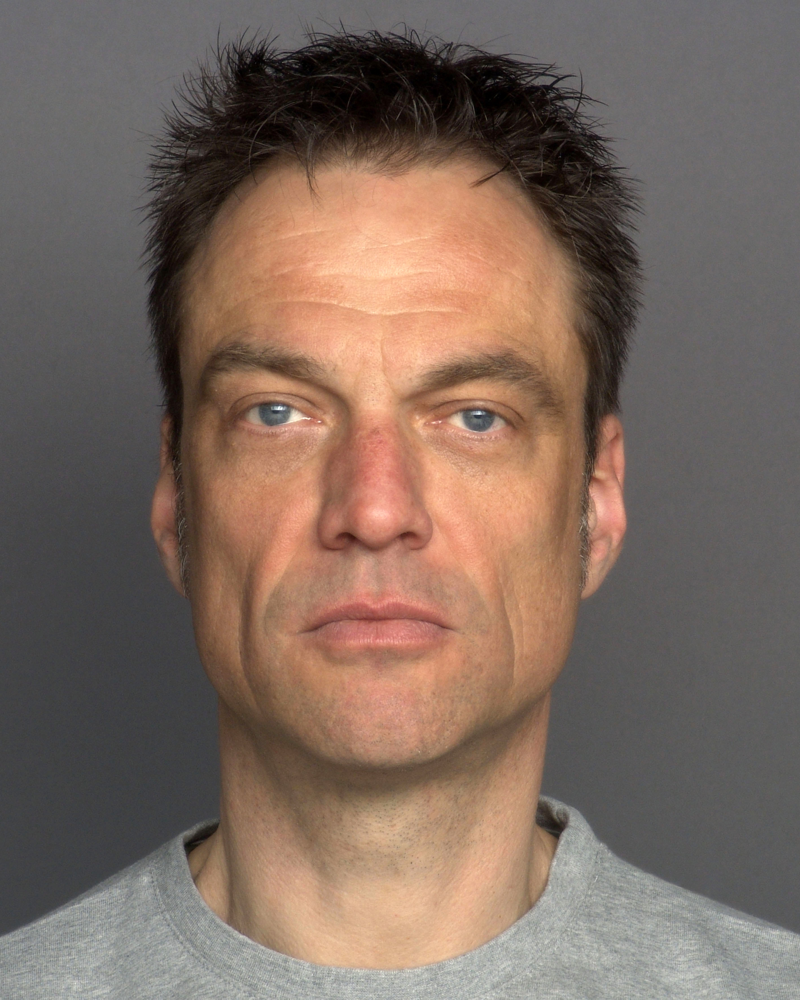

image size (3543, 2835, 3) 


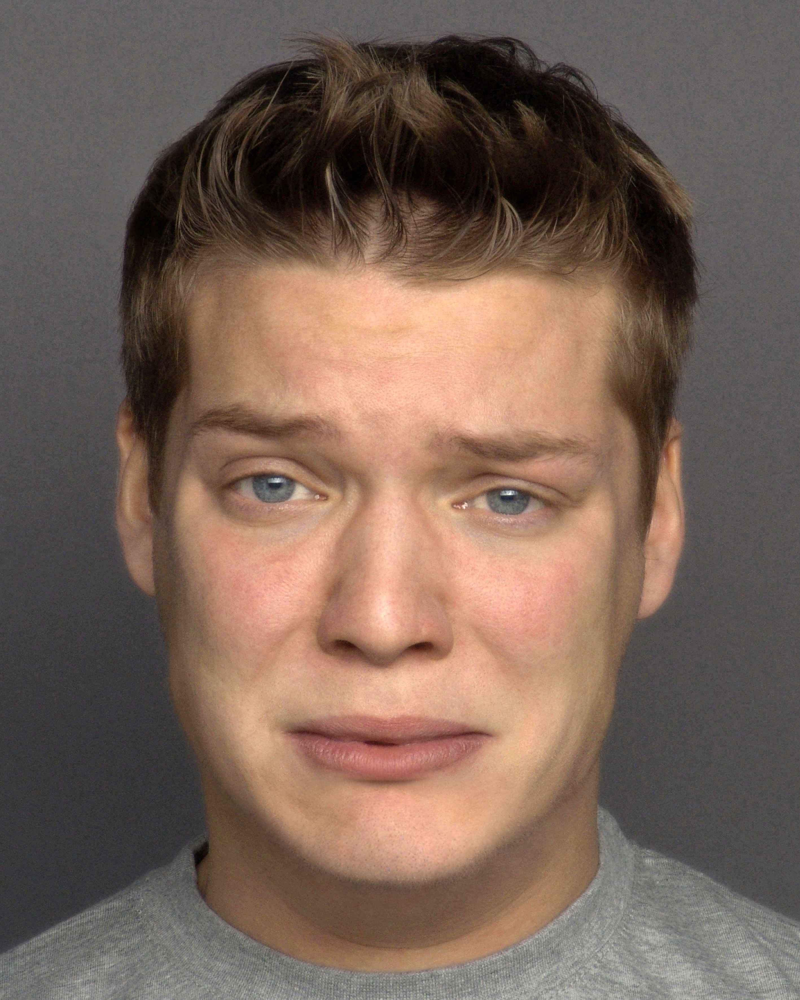

image size (3543, 2835, 3) 


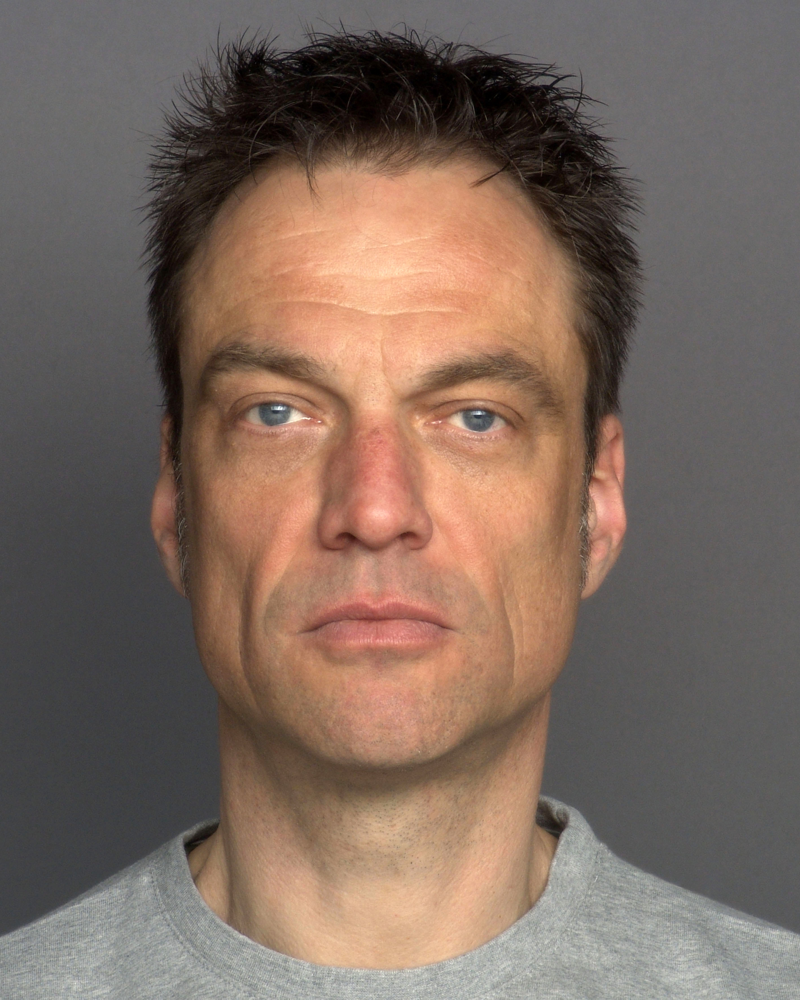

image size (3543, 2835, 3) 


In [0]:
# Plot to see some images of the dataset
for i in range(3):
  rndIndx = random.randint(0,len(face_train)-1)
  img = cv2.imread(os.path.join('data/train/imgs/Face_Train',face_train[rndIndx]))
  cv2_imshow(img)
  print('image size {} '.format(img.shape))


###Create the images dataset

In [0]:
X_train = create_img_set(os.path.join('data/train/imgs/Face_Train'))

In [0]:
X_test = create_img_set(os.path.join('data/test/imgs/Face_Test'))

Show some randomly images from the training set

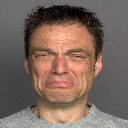

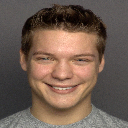

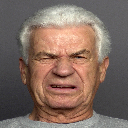

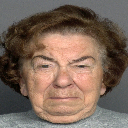

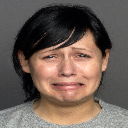

...

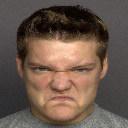

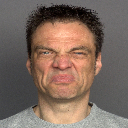

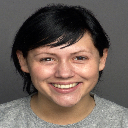

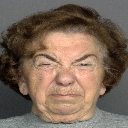

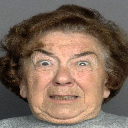

In [0]:
for i in range(0,12):
  cv2_imshow(X_train[i])

###Flattening the dataset

In [0]:
X_train = np.array(X_train)
X_test = np.array(X_test)

In [0]:
X_train.shape, X_test.shape

((60, 128, 128, 3), (12, 128, 128, 3))

Since the dataset has no y label, manually typing is necessary

In [0]:
label = ['anger','disgust','fear','happiness','neutrality','sadness']

In [0]:
#y_train = [[5],[3],[1],[5],[5],[3],[5],[0],[1],[3],
#           [1],[2],[3],[0],[1],[5],[4],[3],[4],[2],
#           [4],[0],[3],[0],[1],[3],[2],[0],[1],[5],
#           [2],[2],[3],[5],[4],[0],[4],[4],[5],[3],
#           [5],[2],[1],[4],[0],[1],[2],[4],[0],[2],
#           [5],[2],[4],[0],[4],[0],[5],[1],[2],[5]]

In [0]:
y_train = [5,3,1,5,5,3,5,0,1,3,
           1,2,3,0,1,5,4,3,4,2,
           4,0,3,0,1,3,2,0,1,5,
           2,2,3,5,4,0,4,4,5,3,
           5,2,1,4,0,1,2,4,0,2,
           5,2,4,0,4,0,5,1,2,5]

In [0]:
y_train = to_categorical(y_train,num_classes=len(label))

In [0]:
#y_train = np.vstack(y_train)

In [0]:
#y_test = [[5],[1],[3],[0],[2],[4],
#          [0],[4],[5],[2],[1],[3]]

In [0]:
y_test = [5,1,3,0,2,4,0,4,5,2,1,3]
y_test = to_categorical(y_test,num_classes=len(label))

In [0]:
#y_test = np.vstack(y_test)

In [0]:
# Convert class vectors to binary class matrices. This uses 1 hot encoding.
#y_train = keras.utils.to_categorical(y_train, label) 
#y_test = keras.utils.to_categorical(y_test, label)

##CNN one layer 

In [0]:
import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D

cnn1 = Sequential()
cnn1.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(128,128,3)))
cnn1.add(MaxPooling2D(pool_size=(3, 3)))
cnn1.add(Dropout(0.2))

cnn1.add(Flatten())

cnn1.add(Dense(42, activation='relu'))
cnn1.add(Dense(6, activation='softmax'))

In [0]:
cnn1.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.Adam(),
              metrics=['accuracy'])

In [0]:
cnn1.summary()

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 126, 126, 32)      896       
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 42, 42, 32)        0         
_________________________________________________________________
dropout_10 (Dropout)         (None, 42, 42, 32)        0         
_________________________________________________________________
flatten_10 (Flatten)         (None, 56448)             0         
_________________________________________________________________
dense_18 (Dense)             (None, 42)                2370858   
_________________________________________________________________
dense_19 (Dense)             (None, 6)                 258       
Total params: 2,372,012
Trainable params: 2,372,012
Non-trainable params: 0
___________________________________________

###Training the model

In [0]:
np.array(y_train).shape

(60, 6)

In [0]:
tr1 = cnn1.fit(X_train, y_train,
          batch_size=10,
          epochs=6,
          verbose=1,
          validation_data=(X_train, y_train))

Train on 60 samples, validate on 60 samples
Epoch 1/6
60/60 [==============================] - 0s 4ms/step - loss: 994.3701 - accuracy: 0.1833 - val_loss: 715.2548 - val_accuracy: 0.1667
Epoch 2/6
60/60 [==============================] - 0s 3ms/step - loss: 598.8101 - accuracy: 0.1667 - val_loss: 461.2081 - val_accuracy: 0.1667
Epoch 3/6
60/60 [==============================] - 0s 3ms/step - loss: 350.0303 - accuracy: 0.1167 - val_loss: 152.6931 - val_accuracy: 0.1500
Epoch 4/6
60/60 [==============================] - 0s 3ms/step - loss: 130.4751 - accuracy: 0.1333 - val_loss: 75.9095 - val_accuracy: 0.1500
Epoch 5/6
60/60 [==============================] - 0s 3ms/step - loss: 65.7966 - accuracy: 0.1833 - val_loss: 30.4049 - val_accuracy: 0.1833
Epoch 6/6
60/60 [==============================] - 0s 3ms/step - loss: 38.3055 - accuracy: 0.2167 - val_loss: 28.7723 - val_accuracy: 0.2000


###See the accuracy

In [0]:
score1 = cnn1.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score1[0])
print('Test accuracy:', score1[1])

Test loss: 31.407506942749023
Test accuracy: 0.1666666716337204


#Conclusion

*   Each dataset has different size and format, and 70% majority of works and time were spent on uploading, downloading and cleaning datasets. The total datasets' size is about 6.5 GB after loaded and unzipped in Google Colab.
*   When using dimensionality reduction, PCA provides RF classifier's prediction accuracies way higher than k-means even both have similar training score. This is because k-mean reduced features too much that could casue data-information-loss. For instance, Coil-100 with PCA(99%) has 755 features and with k-means(k=6) has only 6 features.
*   Selecting n_clusters ($k$) is still in a gray area since there's no specific global theory on how to determine $k$; however, by plotting elbow of $k$ could give us a sense of picking a good number of clusters. For instance, Coil-100 has a 100 different objects; therefore, the number of clusters (labels) should be also a 100; surprisingly, elbow return $k$=6. 
*   For sake computation time, only RandomForest classifier was used for all datasets, and random subsets size 5000 were used for the Celeba and ImageNet dataset.
*   Randomized n_clusters to see the differences of classifier's performance, defenetly a great intuitive to let you pick the best $k$ that can minimize the learning's speed and maximize the learning's performance.


*   Overall, using the $k$-elbow method to define number of clusters doesn't mean these clusters represent as the labels for unlabeled datasets. This is also known as the downfall of clustering technique. Usually, the number of clusters $k$ is predefined by data scientists based on dataset information, such as business segments, groups of customers, groups of products, etc.  
Below are the summary charts of n_clusters vs RF classifier's performance, and PCA vs K-Means.


### ***Bridge and Coil-100 Report***

![alt text](https://github.com/seansothey/CSC685/blob/master/Report2-Project6.PNG?raw=true)


### ***Celeba and ImageNet Report***
![alt text](https://github.com/seansothey/CSC685/blob/master/Report1-Project6.PNG?raw=true)






#Refrences

https://nbviewer.jupyter.org/github/ageron/handson-ml2/blob/master/09_unsupervised_learning.ipynb

https://stackoverflow.com/questions/16760992/how-to-download-a-zip-file-from-a-site-python

https://stackabuse.com/download-files-with-python/

https://jakevdp.github.io/PythonDataScienceHandbook/05.12-gaussian-mixtures.html 

https://www.scikit-yb.org/en/latest/api/cluster/elbow.html
